In [1]:
!date

Thu Jun 24 12:15:46 PDT 2021


## Import packages. 

In [2]:
import numpy as np
import pandas as pd
import scanpy as sc
import anndata

from sklearn.decomposition import TruncatedSVD
from sklearn.neighbors import NeighborhoodComponentsAnalysis
from sklearn.manifold import TSNE

import matplotlib
import matplotlib.pyplot as plt

%config InlineBackend.figure_format = 'retina'

## Read in the data

In [6]:
adata = anndata.read_h5ad("../notebooks/adata.h5ad")
adata

AnnData object with n_obs × n_vars = 4840 × 33694
    obs: 'batch', 'sample_id', 'sample_number', 'cell_group'
    var: 'gene_ids', 'feature_types', 'gene_name'

## Process the data

In [7]:
# Add number of genes and number of counts to adata.obs
adata.obs["n_genes"] = np.asarray((adata.X>0).sum(axis=1)).reshape(-1)
adata.obs["n_counts"] = np.asarray(adata.X.sum(axis=1)).reshape(-1)

#### Mitochondrial content analysis 
See [Introduction to single-cell RNA-seq II: getting started with analysis](https://www.kallistobus.tools/tutorials/kb_getting_started/python/kb_intro_2_python/) for more information. 


In [8]:
# Desginates mitochondrial genes
mito_genes = adata.var.gene_name.str.startswith('MT-')

# For each cell compute fraction of counts in mito genes vs. all genes
# the `.A1` is only necessary as X is sparse (to transform to a dense array after summing)
adata.obs['percent_mito'] = np.sum(
    adata[:, mito_genes].X, axis=1).A1 / np.sum(adata.X, axis=1).A1

# add the total counts per cell as observations-annotation to adata
adata.obs['n_counts'] = adata.X.sum(axis=1).A1

Visualize mitochondrial content for all data.

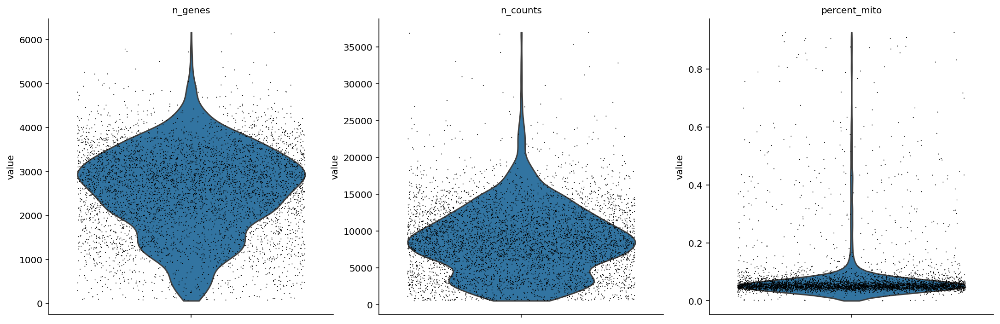

In [9]:
sc.pl.violin(adata, ['n_genes', 'n_counts', 'percent_mito'],
             jitter=0.4, multi_panel=True)

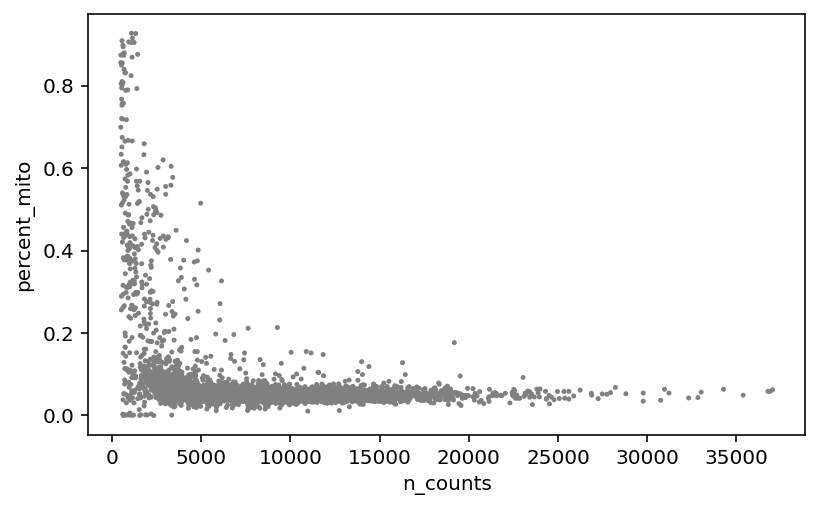

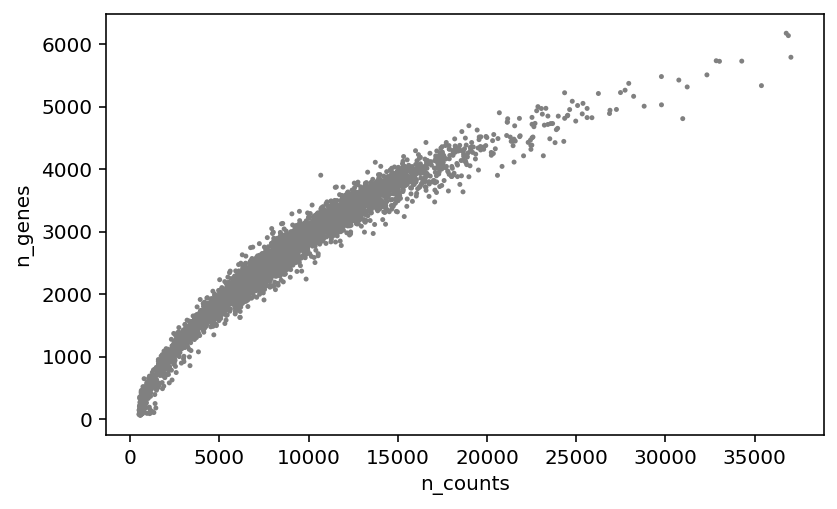

In [10]:
#examine mitochondrial content 
sc.pl.scatter(adata, x='n_counts', y='percent_mito')
sc.pl.scatter(adata, x='n_counts', y='n_genes')

Visualize mitochondrial content by sample.

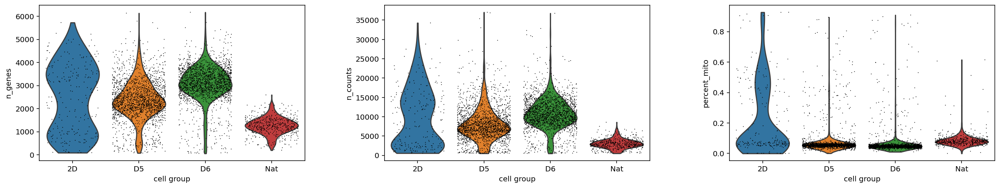

In [11]:
sc.pl.violin(adata, ['n_genes', 'n_counts', 'percent_mito'], groupby="cell_group",
             jitter=0.4, multi_panel=True)

## Save raw adata

In [12]:
adata.raw = adata

## Highly variable genes

In [13]:
# Generate list of highly variable genes.
sc.pp.highly_variable_genes(adata,
                            min_mean=0.01, 
                            max_mean=8, 
                            min_disp=1, 
                            n_top_genes=2000, 
                            flavor="seurat_v3", 
                            n_bins=20)

## Normalize and log the data

In [14]:
# Normalize the data.
sc.pp.normalize_total(adata, target_sum=1e4)

# Log the data.
sc.pp.log1p(adata)

## Scale the data

In [15]:
# Scale the data. 
sc.pp.scale(adata, max_value=10)

## PCA the data

In [16]:
# Performs PCA.
sc.tl.pca(adata, 
          svd_solver='arpack', 
          use_highly_variable=True)

## Perform Neighbor Analysis on the data

In [17]:
# Performs neighbor analysis.
sc.pp.neighbors(adata, 
                n_neighbors=30, 
                n_pcs=50, 
                random_state=42)

## Perform louvain clustering on the data

In [18]:
# sc.tl.louvain(adata)

## Score UMAP

In [19]:
# Performs UMAP calculation. 
sc.tl.umap(adata)

___
# SCORING for potential "lineage" segregation.
____

In [20]:
# Reads in a list of genes for each lineage from from supplementary table 12 of Liu et al.
df_lineage = pd.read_csv('../MZG_data/supp12.csv')
epi_markers = df_lineage.loc[df_lineage["type"]=="ALL-EPI"]["geneName"].values
hypo_markers = df_lineage.loc[df_lineage["type"]=="ALL-PE"]["geneName"].values
te_markers = df_lineage.loc[df_lineage["type"]=="ALL-TE"]["geneName"].values

# Reads in a list of genes for hEPSCs from Yan et al. 
df_epscs = pd.read_csv("../MZG_data/epsc_genes.csv", usecols=[0])                       
epsc_markers = df_epscs["Genes"].values

In [21]:
# Makes sure that all genes in lineage gene lists are also present in the data set. 
epi_markers_present = []
for marker in epi_markers:
    if marker in adata.var["gene_name"]:
        epi_markers_present.append(marker)
        
hypo_markers_present = []
for marker in hypo_markers:
    if marker in adata.var["gene_name"]:
        hypo_markers_present.append(marker)
        
te_markers_present = []
for marker in te_markers:
    if marker in adata.var["gene_name"]:
        te_markers_present.append(marker)
        
epsc_markers_present = []
for marker in epsc_markers:
    if marker in adata.var["gene_name"]:
        epsc_markers_present.append(marker)

In [22]:
# Makes a library for each list of genes.
marker_genes_dict = {"epi":epi_markers_present, 
                     "hypo":hypo_markers_present, 
                     "te":te_markers_present,
                     "epsc": epsc_markers_present}

In [23]:
# Calculates a "score" for every cell and every lineage, as well as an EPSC score.

ctrl_size_var = 50

sc.tl.score_genes(adata, te_markers_present, ctrl_size=ctrl_size_var, score_name="te_score", use_raw=False)
sc.tl.score_genes(adata, epi_markers_present, ctrl_size=ctrl_size_var, score_name="epi_score", use_raw=False)
sc.tl.score_genes(adata, hypo_markers_present, ctrl_size=ctrl_size_var, score_name="hypo_score", use_raw=False)
sc.tl.score_genes(adata, epsc_markers_present, ctrl_size=ctrl_size_var, score_name="epsc_score", use_raw=False)
# sc.tl.score_genes(adata_epsc_nat, epsc_markers_present, ctrl_size=ctrl_size_var, score_name="epsc_score", use_raw=False)

The below code assigns a putative lineage title to each cell.  Every cell receives 3 scores for EPI, HYPO, and TE; whichever of the 3 is highest for that given cell determines the "lineage" of that cell. Note that cells without a distinct lineage, as determined by having all 3 scores below 0.08, are titled "undefined" (see below).

In [24]:
# All cells start as undefined.
adata.obs["lineage"] = "undefined"

# Assigns lineage based on where the highest lineage score comes from. 
# Assigns EPI group
adata.obs.loc[(adata.obs["epi_score"]>adata.obs["hypo_score"]) 
              & (adata.obs["epi_score"]>adata.obs["te_score"]), "lineage"] = "epi"

# Assigns HYPO group
adata.obs.loc[(adata.obs["hypo_score"]>adata.obs["te_score"]) 
              & (adata.obs["hypo_score"]>adata.obs["epi_score"]), "lineage"] = "hypo"

# Assigns TE group
adata.obs.loc[(adata.obs["te_score"]>adata.obs["hypo_score"]) 
              & (adata.obs["te_score"]>adata.obs["epi_score"]), "lineage"] = "te"


# Shows counts for all lineages.
adata.obs.lineage.value_counts()

hypo    2409
epi     1407
te      1024
Name: lineage, dtype: int64

Here we assign "undefined" lineages based on scores from Natural embryo.  
  

In [25]:
# Assigns cells as undefined if lineage is not well defined.
adata.obs.loc[((adata.obs["hypo_score"]<0.08) 
               & (adata.obs["te_score"]<0.08) 
               & (adata.obs["epi_score"]<0.08)) , "lineage"] ="undefined"
adata.obs.lineage.value_counts()

undefined    2586
hypo         1068
te            608
epi           578
Name: lineage, dtype: int64

___
# Establish labels and groupings for later analysis
___

#### Make "sample_group" column to distinguish batches.

In [26]:
# Give labels a more descriptive name 
adata.obs.loc[(adata.obs["cell_group"]=="Nat"), "sample_group"] = "Natural human embryo"
adata.obs.loc[(adata.obs["cell_group"]=="D5"), "sample_group"] = "Day 5 hEP-structures"
adata.obs.loc[(adata.obs["cell_group"]=="D6"), "sample_group"] = "Day 6 hEP-structures"
adata.obs.loc[(adata.obs["cell_group"]=="2D"), "sample_group"] = "hEPSCs in 2D"
# adata.obs.loc[(adata.obs["cell_group"]=="unknown"), "sample_group"] = "unknown"

#### Make "lineage_id" column to distinguish Natural lineages and synthetic "lineages".  (Does not combine D5 and D6)

In [27]:
adata.obs["lineage_id"] = "Undefined"
adata.obs.loc[((adata.obs["lineage"]=="epi") & (adata.obs["cell_group"]=="Nat")), "lineage_id"] = "Epiblast"
adata.obs.loc[((adata.obs["lineage"]=="epi") & (adata.obs["cell_group"]=="D5")), "lineage_id"] = "D5 ELCs"
adata.obs.loc[((adata.obs["lineage"]=="epi") & (adata.obs["cell_group"]=="D6")), "lineage_id"] = "D6 ELCs"

adata.obs.loc[((adata.obs["lineage"]=="hypo") & (adata.obs["cell_group"]=="Nat")), "lineage_id"] = "Hypoblast"
adata.obs.loc[((adata.obs["lineage"]=="hypo") & (adata.obs["cell_group"]=="D5")), "lineage_id"] = "D5 HLCs"
adata.obs.loc[((adata.obs["lineage"]=="hypo") & (adata.obs["cell_group"]=="D6")), "lineage_id"] = "D6 HLCs"

adata.obs.loc[((adata.obs["lineage"]=="te") & (adata.obs["cell_group"]=="Nat")), "lineage_id"] = "Trophectoderm"
adata.obs.loc[((adata.obs["lineage"]=="te") & (adata.obs["cell_group"]=="D5")), "lineage_id"] = "D5 TLCs"
adata.obs.loc[((adata.obs["lineage"]=="te") & (adata.obs["cell_group"]=="D6")), "lineage_id"] = "D6 TLCs"

adata.obs.loc[((adata.obs["lineage"]=="undefined")), "lineage_id"] = "Undefined"
adata.obs.loc[((adata.obs["cell_group"]=="2D")), "lineage_id"] = "2D EPSCs"

# Shows counts for all lineages.
adata.obs.lineage_id.value_counts()

Undefined        2552
D6 HLCs           586
Trophectoderm     484
D5 HLCs           445
D5 ELCs           235
2D EPSCs          228
D6 ELCs           144
D6 TLCs            73
D5 TLCs            50
Epiblast           32
Hypoblast          11
Name: lineage_id, dtype: int64

#### Make "name" column to distinguish Natural lineages and synthetic "lineages". (combines D5 and D6)

In [28]:
adata.obs["name"] = "Undefined"
adata.obs.loc[((adata.obs["lineage"]=="epi") & (adata.obs["cell_group"]=="Nat")), "name"] = "Epiblast"
adata.obs.loc[((adata.obs["lineage"]=="epi") & (adata.obs["cell_group"]=="D5")), "name"] = "ELCs"
adata.obs.loc[((adata.obs["lineage"]=="epi") & (adata.obs["cell_group"]=="D6")), "name"] = "ELCs"

adata.obs.loc[((adata.obs["lineage"]=="hypo") & (adata.obs["cell_group"]=="Nat")), "name"] = "Hypoblast"
adata.obs.loc[((adata.obs["lineage"]=="hypo") & (adata.obs["cell_group"]=="D5")), "name"] = "HLCs"
adata.obs.loc[((adata.obs["lineage"]=="hypo") & (adata.obs["cell_group"]=="D6")), "name"] = "HLCs"

adata.obs.loc[((adata.obs["lineage"]=="te") & (adata.obs["cell_group"]=="Nat")), "name"] = "Trophectoderm"
adata.obs.loc[((adata.obs["lineage"]=="te") & (adata.obs["cell_group"]=="D5")), "name"] = "TLCs"
adata.obs.loc[((adata.obs["lineage"]=="te") & (adata.obs["cell_group"]=="D6")), "name"] = "TLCs"

adata.obs.loc[((adata.obs["lineage"]=="undefined")), "name"] = "Undefined"
adata.obs.loc[((adata.obs["cell_group"]=="2D")), "name"] = "2D EPSCs"


___
# Make various subsets of adata
___

In [29]:
# Subset to look at each cell group
adata_2D = adata[adata.obs['cell_group']== '2D'] 
adata_pre = adata[adata.obs['cell_group']== 'D5'] 
adata_post = adata[adata.obs['cell_group']== 'D6'] 
adata_nat = adata[adata.obs['cell_group']== 'Nat']


adata_epsc_nat = adata[(adata.obs['cell_group'] != 'D5') &
                       (adata.obs['cell_group'] != 'D6')]

# Subset to look at each lineage
adata_lineage = adata[adata.obs['lineage']!= 'undefined'] 

# Subset excluding natural samples
adata_epscs = adata[adata.obs['cell_group'] != 'Nat']

# Subset with synthetic structures only
adata_synth = adata_epscs[adata_epscs.obs['cell_group'] != '2D']
adata_synth = adata_synth[adata_synth.obs['lineage_id'] != 'Undefined']
adata_synth = adata_synth[adata_synth.obs['lineage'] != 'undefined']

# Subset for EPI and ELCs
adata_epi = adata[adata.obs['lineage']== 'epi'] 
adata_epi = adata[(adata.obs['lineage_id']== 'Epiblast') | 
                  (adata.obs['lineage_id']== 'D5 ELCs') |  
                  (adata.obs['lineage_id']== 'D6 ELCs')] 


# Subset for HYPO and HLCs
adata_hypo = adata[adata.obs['lineage']== 'hypo']
adata_hypo = adata[(adata.obs['lineage_id']== 'Hypoblast') | 
                  (adata.obs['lineage_id']== 'D5 HLCs') |  
                  (adata.obs['lineage_id']== 'D6 HLCs')] 


# Subset for TE and TLCs
adata_te = adata[adata.obs['lineage']== 'te']
adata_te = adata[(adata.obs['lineage_id']== 'Trophectoderm') | 
                  (adata.obs['lineage_id']== 'D5 TLCs') |  
                  (adata.obs['lineage_id']== 'D6 TLCs')] 


adata_name = adata[adata.obs['lineage'] != 'undefined']
# adata_name = adata_name[adata_name.obs['name'] != '2D EPSCs']

adata_lineage = adata[adata.obs['lineage']!= 'undefined'] 
adata_lineage = adata_lineage[adata_lineage.obs['name']!= '2D EPSCs'] 

### Generate color palettes

In [30]:
palette_umap = {"Epiblast":'darkcyan', 
                "Hypoblast":"darkgoldenrod", 
                "Trophectoderm":"mediumvioletred", 
                "Undefined":"whitesmoke", 
                "D5 ELCs":'aquamarine', 
                "D5 HLCs":"khaki", 
                "D5 TLCs":"hotpink",  
                "D6 ELCs":'turquoise', 
                "D6 HLCs":"gold", 
                "D6 TLCs":"deeppink",
                "nan":"whitesmoke",
                "epi":'lightseagreen', 
                "hypo":"goldenrod", 
                "te":"mediumvioletred", 
                "undefined":"whitesmoke",
                "2D EPSCs":'royalblue',
                "2D":'royalblue',
                "ELCs":'lightseagreen', 
                "HLCs":"goldenrod", 
                "TLCs":"deeppink"}

# Assigns colors for UMAP.
colors_umap = {"Day 5 hEP-structures":'dodgerblue', 
                "Day 6 hEP-structures":"hotpink", 
                "Natural human embryo":"gold", 
                "hEPSCs in 2D":"thistle"}

___
# FIGURES
___

### Components necessary for figure generation.

Statistical analysis was done by taking the mean expression and standard deviation of D5 and D6 XLCs and comparing values to the equivalent lineage in natural embryos. See "statistical_analysis" notebook for more. 

In [31]:
# Load in statistical analysis for HYPO related cells. 
df_hypo_p = pd.read_csv("../MZG_data/HYPO_pval.csv")

# Load in statistical analysis for EPI related cells. 
df_epi_p = pd.read_csv("../MZG_data/EPI_pval.csv")

# Load in statistical analysis for TE related cells.
df_te_p = pd.read_csv("../MZG_data/TE_pval.csv")

Below we define a function to add significance markers above the violin plots. 

In [32]:
# Function to add significance to violin plots.
def is_number(s):
    try:
        float(s)
        return True
    except ValueError:
        return False

def add_significance(plot, x1, x2, values1, values2, p):
    y, h, col = max(max(values1),max(values2)) , 0.5, 'k'
    if y>30:
        h = 3
    if y<5:
        h=0.5
    if is_number(p):
        p=float(p)
        if p <= 0.0001 :
            TXT = "****"
        elif p <=  0.001:
            TXT = "***"
        elif p< 0.01:
            TXT = "**"
        elif p< 0.05:
            TXT = "*"
        else:
            TXT = "ns"
    else:
        TXT = "****"
    plot.plot([x1, x1, x2, x2], [y, y+h, y+h, y], lw=1.5, c=col)
    plot.text((x1+x2)*.5, y+h, TXT, ha='center', va='bottom', color=col)
    plot.set_ylim(top=y+h+1)
    if y>30:
        plot.set_ylim(top=y+h+3)
    if y<5:
        plot.set_ylim(top=y+h+0.5)

### Figure 5A: Batch UMAP

[Text(0.5, 0, ''), Text(0, 0.5, '')]

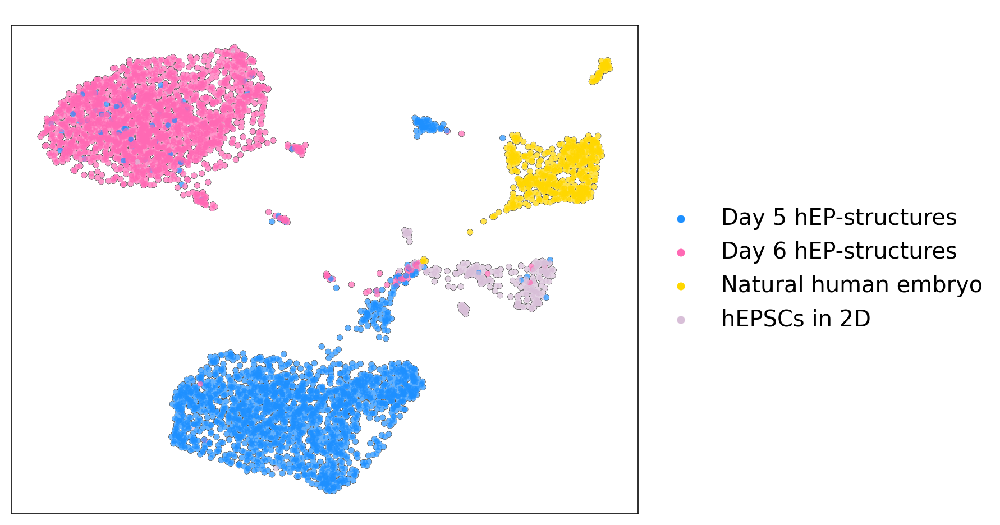

In [33]:
# Establish figure axis
fig5a, (ax0) = plt.subplots(1, 1, figsize=(10,8))

# Figure 5a for sample clustering UMAP
sc.pl.umap(adata, color="sample_group", 
           add_outline=True, 
           outline_width=[0.05, 0.01], 
           size=100, 
           legend_fontsize=20, 
           palette = colors_umap, 
           ax=ax0,
           wspace=5,
           title="  ",
           show=False)
ax0.set(xlabel=None, ylabel=None)
# fig5a.savefig("../figures/fig5a.png", bbox_inches="tight")

### Figure 5B: Lineage UMAP

[Text(0.5, 0, ''), Text(0, 0.5, '')]

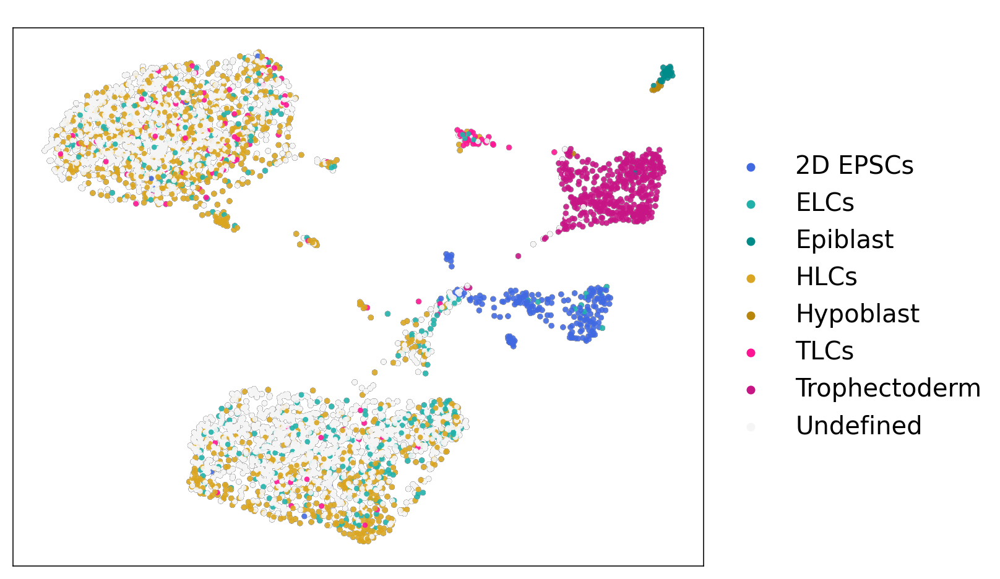

In [34]:
# Establish figure axis
fig5b, (ax1) = plt.subplots(1, 1, figsize=(10,8))

# Figure 5b for lineage scoring UMAP
sc.pl.umap(adata, color="name", 
           add_outline=True, 
           outline_width=[0.03, 0.01], 
           size=75, 
           legend_fontsize=20, 
           cmap="bwr",
           palette = palette_umap, 
           ax=ax1,
           wspace=5,           
           title="  ",
           alpha=0.9,
           show=False)
ax1.set(xlabel=None, ylabel=None)

# Save figure
# fig5b.savefig("../figures/fig5b.png", bbox_inches="tight")

### Figure 5D: Heatmaps for TE lineage and D5 TLC cluster

Text(0.67, 0.27, 'KRT7')

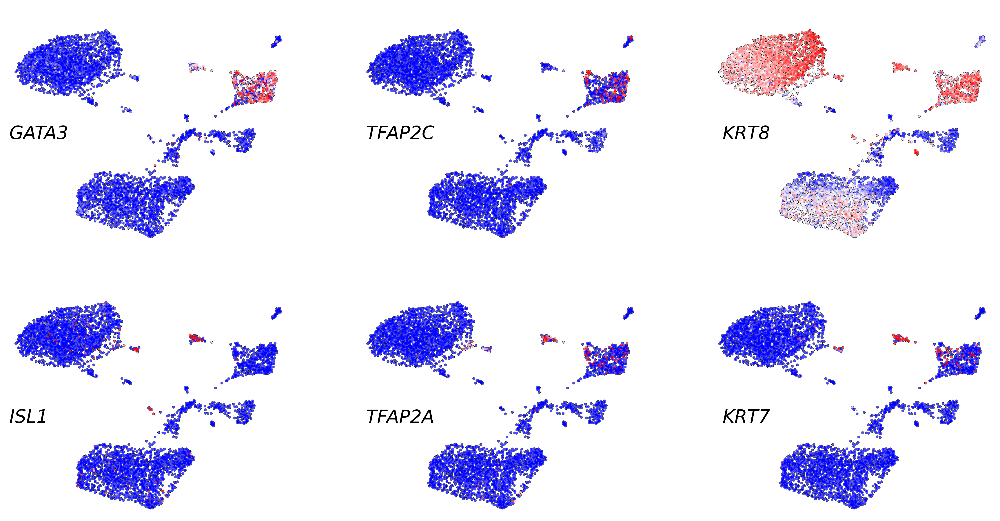

In [35]:
plt.rcParams.update({"font.size":50})
matplotlib.rcParams['axes.titlesize'] = 50

vmax_var = "p99"
vmin_var = "p10"

fig, axes= plt.subplots(2,3, figsize=(50,25), gridspec_kw={'wspace':0.1})
list_genes = ["GATA3", "TFAP2C", "KRT8", 
              "ISL1", "TFAP2A", "KRT7"]

for i, marker in enumerate(list_genes):
    sc.pl.umap(adata, 
                 color=list_genes[i], 
                 add_outline=True, 
                 outline_width=[0.1, 0.01],  
                 vmax=vmax_var, 
                 vmin=vmin_var, 
                 ax=axes[int(i/3)][i%3], 
                 color_map="bwr", 
                 size=150,
                 show=False, 
                 use_raw=False,
                  title="  ")
    axes[int(i/3)][i%3].axis('off')
    axes[int(i/3)][i%3].collections[-1].colorbar.remove()
    
fig.text(0.13, 0.7, list_genes[0], fontname="sans-serif", fontstyle="italic")
fig.text(0.40, 0.7, list_genes[1], fontname="sans-serif", fontstyle="italic")
fig.text(0.67, 0.7, list_genes[2], fontname="sans-serif", fontstyle="italic")
fig.text(0.13, 0.27, list_genes[3], fontname="sans-serif", fontstyle="italic")
fig.text(0.40, 0.27, list_genes[4], fontname="sans-serif", fontstyle="italic")
fig.text(0.67, 0.27, list_genes[5], fontname="sans-serif", fontstyle="italic")
    
# fig.savefig("../figures/fig5d.png")

### Figure 5E: Violin plots for lineage markers in ELCs, HLCs, and TLCs

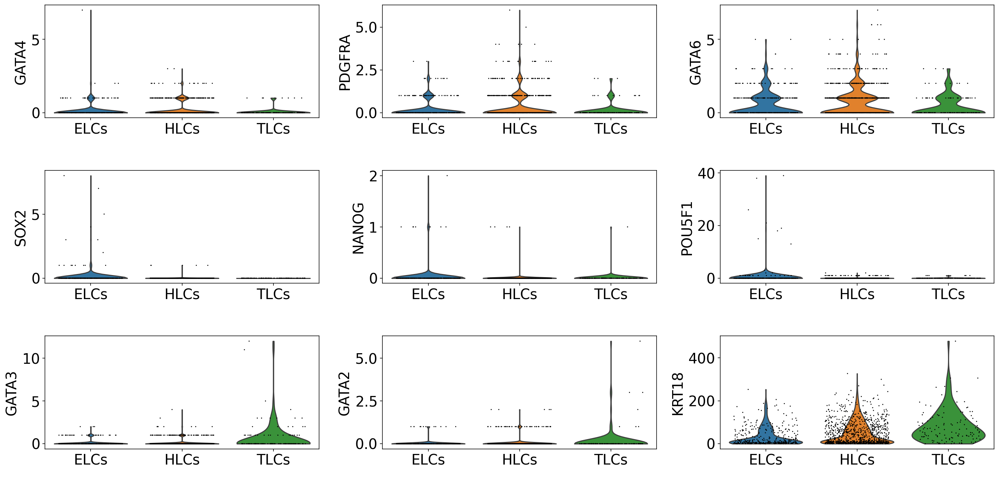

In [37]:
plt.rcParams.update({"font.size":20})
matplotlib.rcParams['axes.titlesize'] = 15

fig, axes= plt.subplots(3,3,figsize=(20,10))
markers = ["GATA4", "PDGFRA", "GATA6",
           "SOX2", "NANOG", "POU5F1",
           "GATA3", "GATA2", "KRT18"]

for i, marker in enumerate(markers):
    sc.pl.violin(adata_synth, 
              marker, 
              groupby="name",
              ax =axes[int(i/3)][i%3],
              jitter=0.35, 
              multi_panel=False,
              show=False,
              size=1.5,
              xlabel="  ")
    
fig.tight_layout()
# fig.savefig("../figures/fig5e.png")

#### Figure 5F: Violin plots for lineage markers in D5 XLCs, D6 XLCs, and natural embryo.

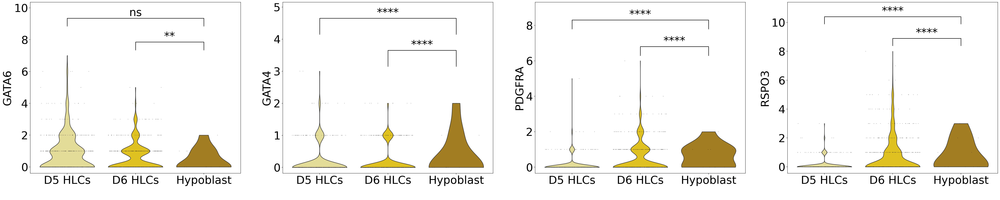

In [84]:
plt.rcParams.update({"font.size":35})
matplotlib.rcParams['axes.titlesize'] = 55

fig, axes= plt.subplots(1,4,figsize=(55,10))
markers = ["GATA6", "GATA4", "PDGFRA", "RSPO3"]

for i, marker in enumerate(markers):
    sc.pl.violin(adata_hypo, 
              marker, 
              groupby="lineage_id",
              ax =axes[i],
              jitter=0.4, 
              multi_panel=False,
              show=False,
              palette=palette_umap,
              xlabel=" ")

# Add in significance.
for i, plot in enumerate(fig.get_axes()):
    add_significance(plot, 1, 2, plot.get_ylim(), plot.get_ylim(), df_hypo_p.loc[df_hypo_p.gene==markers[i]]["D6 Dunnet pval"].values[0])
    add_significance(plot, 0, 2, plot.get_ylim(), plot.get_ylim(), df_hypo_p.loc[df_hypo_p.gene==markers[i]]["D5 Dunnet pval"].values[0])
    
# fig.savefig("../figures/fig5f_HLC.png")

/Users/vickijorgensen/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1208: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'lineage' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sample_group' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'lineage_id' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'name' as categorical


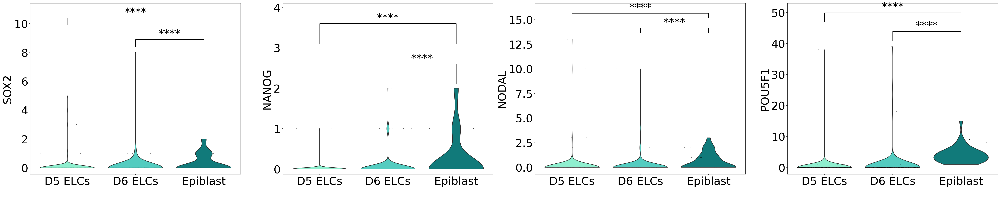

In [85]:
plt.rcParams.update({"font.size":35})
matplotlib.rcParams['axes.titlesize'] = 55

fig, axes= plt.subplots(1,4,figsize=(55,10))
markers = ["SOX2", "NANOG", "NODAL", "POU5F1"]

for i, marker in enumerate(markers):
    sc.pl.violin(adata_epi, 
              marker, 
              groupby="lineage_id",
              ax =axes[i],
              jitter=0.4, 
              multi_panel=False,
              show=False,
              palette=palette_umap,
              xlabel=" ")


for i, plot in enumerate(fig.get_axes()):
    add_significance(plot, 1, 2, plot.get_ylim(), plot.get_ylim(), df_epi_p.loc[df_epi_p.gene==markers[i]]["D6 Dunnet pval"].values[0])
    add_significance(plot, 0, 2, plot.get_ylim(), plot.get_ylim(), df_epi_p.loc[df_epi_p.gene==markers[i]]["D5 Dunnet pval"].values[0])
    
# fig.savefig("../figures/fig5f_ELC.png")    

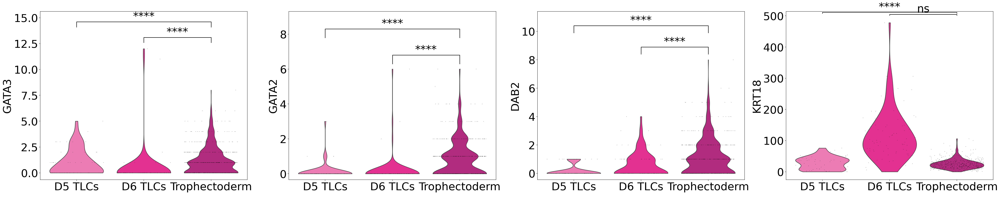

In [86]:
plt.rcParams.update({"font.size":35})
matplotlib.rcParams['axes.titlesize'] = 55

fig, axes= plt.subplots(1,4,figsize=(55,10))
markers = ["GATA3", "GATA2", "DAB2", "KRT18"]

for i, marker in enumerate(markers):
    sc.pl.violin(adata_te, 
              marker, 
              groupby="lineage_id",
              ax =axes[i],
              jitter=0.4, 
              multi_panel=False,
              show=False,
              palette=palette_umap,
              xlabel=" ")


for i, plot in enumerate(fig.get_axes()):
    add_significance(plot, 1, 2, plot.get_ylim(), plot.get_ylim(), df_te_p.loc[df_te_p.gene==markers[i]]["D6 Dunnet pval"].values[0])
    add_significance(plot, 0, 2, plot.get_ylim(), plot.get_ylim(), df_te_p.loc[df_te_p.gene==markers[i]]["D5 Dunnet pval"].values[0])
    
# fig.savefig("../figures/fig5f_TLC.png")    

___
## Supplementary Figure 4 
___

#### Supplementary Figure 4A. Pluripotency markers:Expression in hEPSCs, hEP-Structures, and Natural Embryo

/Users/vickijorgensen/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1208: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'lineage' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sample_group' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'lineage_id' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'name' as categorical


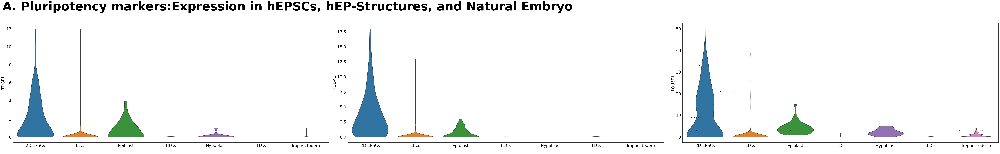

In [38]:
fig, axes= plt.subplots(1,3,figsize=(70,10))

plt.rcParams.update({"font.size":35})
matplotlib.rcParams['axes.titlesize'] = 35

markers = ["TDGF1", "NODAL", "POU5F1"]

for i, marker in enumerate(markers):
    sc.pl.violin(adata_name, 
              marker, 
              groupby="name",
              ax =axes[i],
              jitter=0.4, 
              multi_panel=False,
              show=False,
              xlabel="  ")
fig.tight_layout()

fig.suptitle('A. Pluripotency markers:Expression in hEPSCs, hEP-Structures, and Natural Embryo', 
             fontsize=60, 
             x = 0.29, 
             y = 1.1,
            fontweight="bold")
# fig.savefig("../figures/suppfig4a.png")

#### Supplementary Figure 4B. Antibodies: Expression in hEPSCs, hEP-Structures, and Natural Embryo

In [39]:
fig, axes= plt.subplots(5,2,figsize=(70,60))

plt.rcParams.update({"font.size":40})
# matplotlib.rcParams['axes.titlesize'] = 50

markers = ["SOX2", "GATA3", "PARD6B", 
           "KRT18", "FOXA2", "TFAP2C", 
           "SOX17", "PODXL", "ACTB", "CDH1"]

for i, marker in enumerate(markers):
    sc.pl.violin(adata_name, 
              marker, 
              groupby="name",
              ax = axes[int(i/2)][i%2],
              jitter=0.4, 
              size=3,
              multi_panel=False,
              show=False,
              xlabel=" ")
# fig.tight_layout()

fig.suptitle('B. Antibodies: Expression in hEPSCs, hEP-Structures, and Natural Embryo', 
             fontsize=60, 
             x = 0.35, 
             y = 0.9,
             fontweight="bold")

# fig.savefig("../figures/suppfig4b.png")

#### Supplementary Figure 4C. Genes from Figure 5: Expression in hEPSCs, hEP-Structures, Natural embryo

In [40]:
plt.rcParams.update({"font.size":75})
matplotlib.rcParams['axes.titlesize'] = 100

fig, axes= plt.subplots(3,3,figsize=(150,50))
markers = ["GATA4", "PDGFRA", "GATA6",
           "SOX2", "NANOG", "POU5F1",
           "GATA3", "GATA2", "KRT18"]

for i, marker in enumerate(markers):
    sc.pl.violin(adata_name, 
              marker, 
              groupby="name",
              ax =axes[int(i/3)][i%3],
              jitter=0.35, 
              multi_panel=False,
              show=False,
              size=2,
              xlabel="  ",
              ylabel="  ")
    axes[int(i/3)][i%3].set_title(markers[i])
    
fig.tight_layout()

fig.suptitle('C. Genes from Figure 5: Expression in hEPSCs, hEP-Structures, and Natural Embryo', 
             fontsize=140, 
             x = 0.32, 
             y = 1.05,
             fontweight="bold")

# fig.savefig("../figures/suppfig4c.png")

#### Supplementary Figure 4D. “EPSC score” in hEPSCs and Natural Embryo

/Users/vickijorgensen/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1208: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'lineage' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sample_group' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'lineage_id' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'name' as categorical


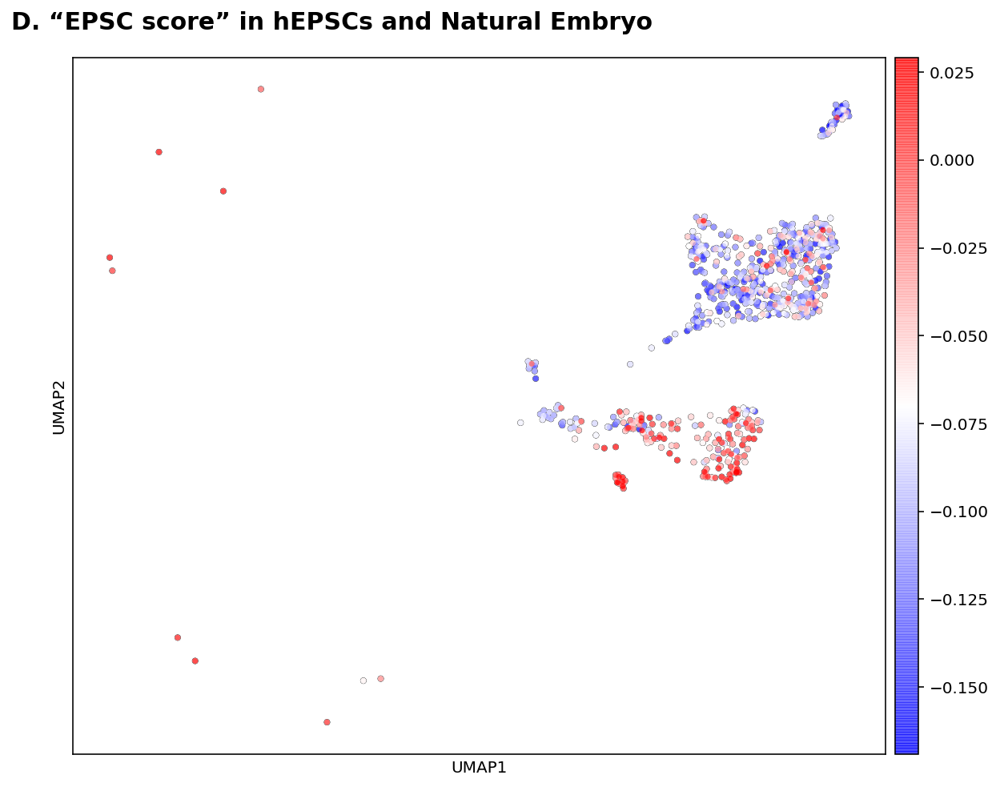

In [41]:
plt.rcParams.update({"font.size":10})
matplotlib.rcParams['axes.titlesize'] = 10

fig, (ax0) = plt.subplots(1, 1, figsize=(10,8))

sc.pl.umap(adata_epsc_nat, 
           color="epsc_score", 
           add_outline=True, 
           outline_width=[0.05, 0.01], 
           size=50, 
           legend_fontsize=10, 
           cmap="bwr", 
           ax=ax0,
           wspace=5, 
           vmin="p5",
           vmax="p95",
           show=False,
           title="  ")

fig.suptitle("D. “EPSC score” in hEPSCs and Natural Embryo", 
             fontsize=15, 
             x = 0.35, 
             y = 0.93,
             fontweight="bold")

# fig.savefig("../figures/suppfig4d.png")

#### Supplementary Figure 4E. “EPSC score” in 2D hEPSCs, hEP-Structures, and Natural Embryo

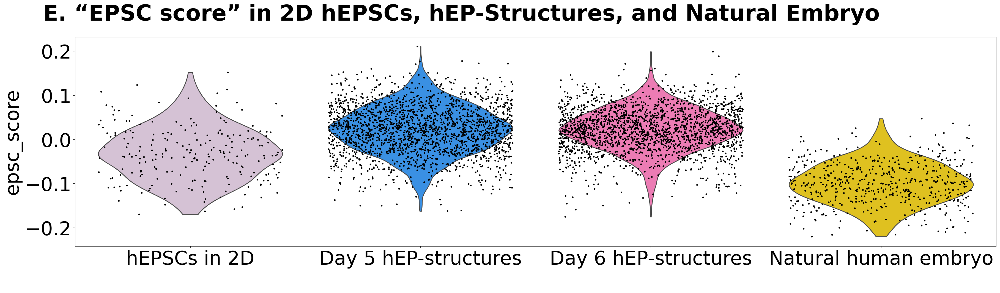

In [43]:
fig, axes= plt.subplots(1,1,figsize=(30,7))

plt.rcParams.update({"font.size":35})
matplotlib.rcParams['axes.titlesize'] = 25


sc.pl.violin(adata, 
          "epsc_score", 
          groupby="sample_group",
          order=["hEPSCs in 2D", "Day 5 hEP-structures", "Day 6 hEP-structures",  "Natural human embryo"],
          ax =axes,
          jitter=0.4, 
          size=3,
          multi_panel=False,
          xlabel="  ",
          show=False)


fig.suptitle('E. “EPSC score” in 2D hEPSCs, hEP-Structures, and Natural Embryo', 
             fontsize=40, 
             x = 0.45, 
             y = 1,
             fontweight="bold")

# fig.savefig("../figures/suppfig4e.png")

___
## Supplementary Figure 5 
___

#### Supplementary Figure 5A. Hypoblast genes: Natural vs. hEP-structures

/Users/vickijorgensen/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1208: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'lineage' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sample_group' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'lineage_id' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'name' as categorical


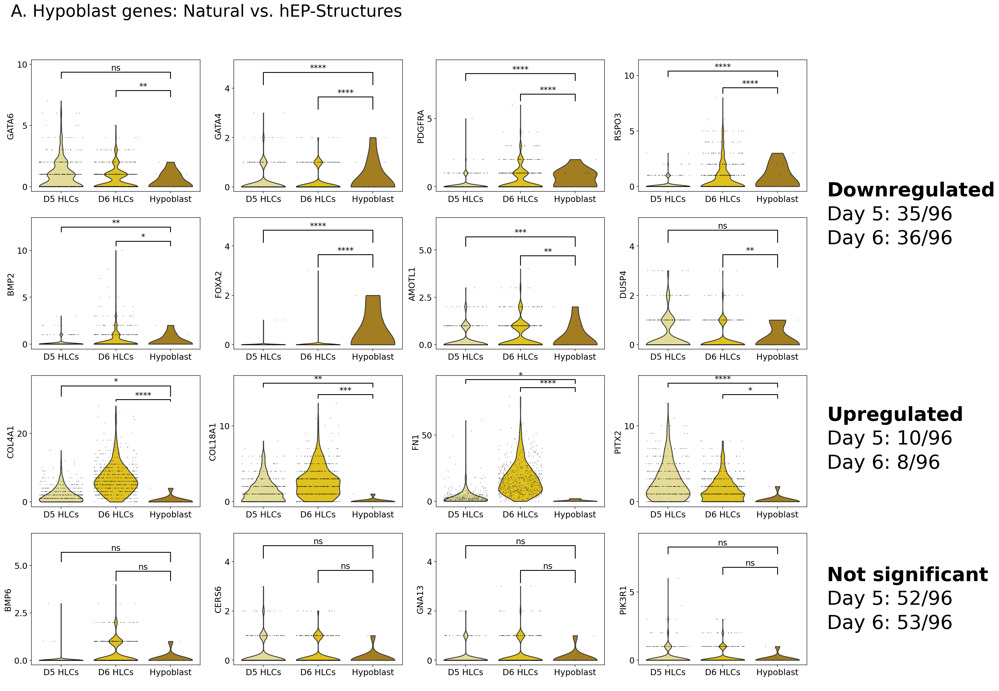

In [44]:
# Plot for HYPO-related genes
plt.rcParams.update({"font.size":15})
matplotlib.rcParams['axes.titlesize'] = 15

fig, axes= plt.subplots(4,4,figsize=(25,20))
hypo_plot = ["GATA6", "GATA4", "PDGFRA", "RSPO3",
            "BMP2", "FOXA2", "AMOTL1", "DUSP4",
            "COL4A1", "COL18A1", "FN1", "PITX2",
            "BMP6", "CERS6", "GNA13", "PIK3R1"]

for i, marker in enumerate(hypo_plot):
    sc.pl.violin(adata_hypo, 
              marker, 
              groupby="lineage_id",
              ax =axes[int(i/4)][i%4],
              jitter=0.4, 
              multi_panel=False,
                 show=False,
                 palette=palette_umap,
                xlabel=" ")

for i, plot in enumerate(fig.get_axes()):
    add_significance(plot, 1, 2, plot.get_ylim(), plot.get_ylim(), df_hypo_p.loc[df_hypo_p.gene==hypo_plot[i]]["D6 Dunnet pval"].values[0])
    add_significance(plot, 0, 2, plot.get_ylim(), plot.get_ylim(), df_hypo_p.loc[df_hypo_p.gene==hypo_plot[i]]["D5 Dunnet pval"].values[0])

plt.rcParams.update({"font.size":35})    
    
fig.text(0.92, 0.71, 'Downregulated', fontweight="bold")
fig.text(0.92, 0.68, 'Day 5: 35/96')
fig.text(0.92, 0.65, 'Day 6: 36/96')

fig.text(0.92, 0.43, 'Upregulated', fontweight="bold")
fig.text(0.92, 0.40, 'Day 5: 10/96')
fig.text(0.92, 0.37, 'Day 6: 8/96')

fig.text(0.92, 0.23, 'Not significant', fontweight="bold")
fig.text(0.92, 0.20, 'Day 5: 52/96')
fig.text(0.92, 0.17, 'Day 6: 53/96')

fig.suptitle('A. Hypoblast genes: Natural vs. hEP-Structures', fontsize=30, x = 0.30, y = 0.95)

# fig.savefig("../figures/suppfig5a.png")

#### Supplementary Figure 5B. Epiblast genes: Natural vs. hEP-structures

/Users/vickijorgensen/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1208: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'lineage' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sample_group' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'lineage_id' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'name' as categorical


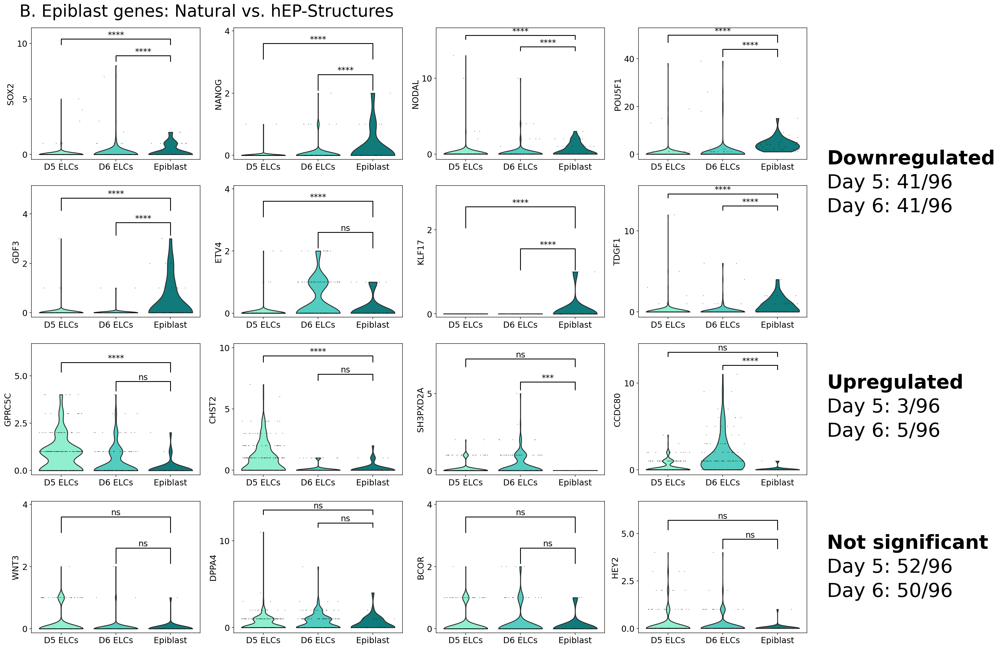

In [45]:
# plot for EPI related genes
plt.rcParams.update({"font.size":15})
matplotlib.rcParams['axes.titlesize'] = 15

fig, axes= plt.subplots(4,4,figsize=(25,20))
epi_plot = ["SOX2", "NANOG", "NODAL", "POU5F1",
            "GDF3", "ETV4", "KLF17", "TDGF1",
            "GPRC5C", "CHST2", "SH3PXD2A", "CCDC80",
            "WNT3", "DPPA4", "BCOR", "HEY2"]

for i, marker in enumerate(epi_plot):
    sc.pl.violin(adata_epi, 
              marker, 
              groupby="lineage_id",
              ax =axes[int(i/4)][i%4],
              jitter=0.4, 
              multi_panel=False,
                 show=False,
                 palette=palette_umap,
                xlabel=" ")
    
for i, plot in enumerate(fig.get_axes()):
    add_significance(plot, 1, 2, plot.get_ylim(), plot.get_ylim(), df_epi_p.loc[df_epi_p.gene==epi_plot[i]]["D6 Dunnet pval"].values[0])
    add_significance(plot, 0, 2, plot.get_ylim(), plot.get_ylim(), df_epi_p.loc[df_epi_p.gene==epi_plot[i]]["D5 Dunnet pval"].values[0])

plt.rcParams.update({"font.size":35})

fig.text(0.92, 0.71, 'Downregulated', fontweight="bold")
fig.text(0.92, 0.68, 'Day 5: 41/96')
fig.text(0.92, 0.65, 'Day 6: 41/96')

fig.text(0.92, 0.43, 'Upregulated', fontweight="bold")
fig.text(0.92, 0.40, 'Day 5: 3/96')
fig.text(0.92, 0.37, 'Day 6: 5/96')

fig.text(0.92, 0.23, 'Not significant', fontweight="bold")
fig.text(0.92, 0.20, 'Day 5: 52/96')
fig.text(0.92, 0.17, 'Day 6: 50/96')

fig.suptitle('B. Epiblast genes: Natural vs. hEP-Structures', fontsize=30, x = 0.30, y = 0.91)

# fig.savefig("../figures/suppfig5b.png")

#### Supplementary Figure 5C. Trophectoderm genes: Natural vs. hEP-structures

/Users/vickijorgensen/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1208: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'lineage' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sample_group' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'lineage_id' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'name' as categorical


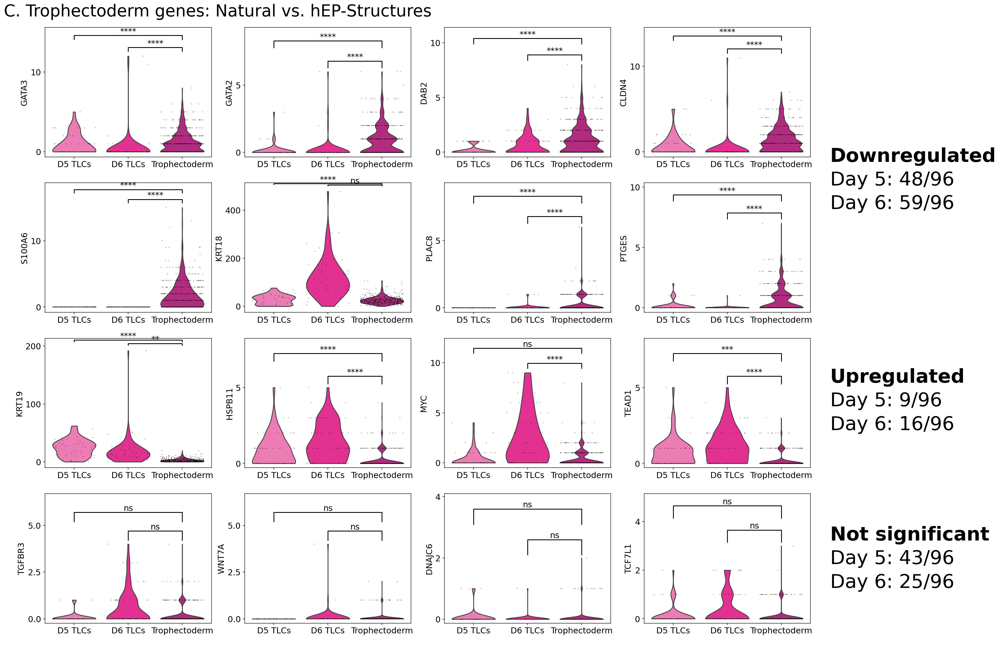

In [46]:
# Plot for TE related genes
plt.rcParams.update({"font.size":15})
matplotlib.rcParams['axes.titlesize'] = 15

fig, axes= plt.subplots(4,4,figsize=(25,20))
te_plot = ["GATA3", "GATA2", "DAB2", "CLDN4",
            "S100A6", "KRT18", "PLAC8", "PTGES",
            "KRT19", "HSPB11", "MYC", "TEAD1",
            "TGFBR3", "WNT7A", "DNAJC6", "TCF7L1"]

for i, marker in enumerate(te_plot):
    sc.pl.violin(adata_te, 
              marker, 
              groupby="lineage_id",
              ax =axes[int(i/4)][i%4],
              jitter=0.4, 
              multi_panel=False,
                 show=False,
                 palette=palette_umap,
                xlabel=" ")
    

for i, plot in enumerate(fig.get_axes()):
    add_significance(plot, 1, 2, plot.get_ylim(), plot.get_ylim(), df_te_p.loc[df_te_p.gene==te_plot[i]]["D6 Dunnet pval"].values[0])
    add_significance(plot, 0, 2, plot.get_ylim(), plot.get_ylim(), df_te_p.loc[df_te_p.gene==te_plot[i]]["D5 Dunnet pval"].values[0])

    
plt.rcParams.update({"font.size":35})
fig.text(0.92, 0.71, 'Downregulated', fontweight="bold")
fig.text(0.92, 0.68, 'Day 5: 48/96')
fig.text(0.92, 0.65, 'Day 6: 59/96')

fig.text(0.92, 0.43, 'Upregulated', fontweight="bold")
fig.text(0.92, 0.40, 'Day 5: 9/96')
fig.text(0.92, 0.37, 'Day 6: 16/96')

fig.text(0.92, 0.23, 'Not significant', fontweight="bold")
fig.text(0.92, 0.20, 'Day 5: 43/96')
fig.text(0.92, 0.17, 'Day 6: 25/96')

fig.suptitle('C. Trophectoderm genes: Natural vs. hEP-Structures', fontsize=30, x = 0.30, y = 0.91)

# fig.savefig("../figures/suppfig5c.png")

#### Supplementary Figure 5D. Extra-cellular matrix genes: Natural vs. hEP-structures

/Users/vickijorgensen/opt/anaconda3/lib/python3.7/site-packages/anndata/_core/anndata.py:1208: ImplicitModificationWarning: Initializing view as actual.
  "Initializing view as actual.", ImplicitModificationWarning
Trying to set attribute `.obs` of view, copying.
... storing 'lineage' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'sample_group' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'lineage_id' as categorical
Trying to set attribute `.obs` of view, copying.
... storing 'name' as categorical


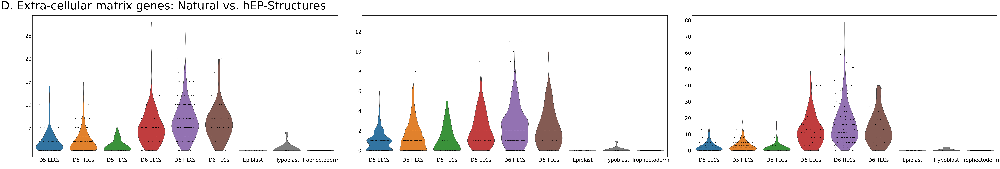

In [47]:
plt.rcParams.update({"font.size":40})

fig, axes= plt.subplots(1,3,figsize=(110,20))
markers = ["COL4A1", "COL18A1", "FN1"]


for i, marker in enumerate(markers):
    sc.pl.violin(adata_lineage, 
                 marker, 
                 groupby="lineage_id",
                 ax =axes[i%3],
                 jitter=0.3, 
                 multi_panel=True,
                 show=False,
                 xlabel=" ",
                 ylabel="  ",
                 size=3)
       
fig.suptitle('D. Extra-cellular matrix genes: Natural vs. hEP-Structures', 
             fontsize=90, 
             x = 0.15, 
             y = 0.96)

fig.tight_layout()

fig.savefig("../figures/suppfig5d.png")

In [48]:
# Save adata.
adata.write("2021-06-14_adata_analyzed.h5ad")

In [49]:
%load_ext watermark
%watermark -v -p numpy,pandas,scanpy,anndata,jupyterlab,matplotlib

CPython 3.7.10
IPython 7.22.0

numpy 1.19.4
pandas 1.1.4
scanpy 1.7.2
anndata 0.7.5
jupyterlab 3.0.11
matplotlib 3.3.4
